#  AIRBNB Capstone Project - Reviews.csv Cleaning/processing/munging

###  This Jupyter notebook is for cleaning and processing the reviews. some EDA following the Vader sentiment analysis is also carried out

1. The data is imported from reviews.csv
2. some initial cleaning and plotting of the review dates is carried out to see if there is any significant time trend.
3. the language of each review is detirmined using langdetect.
4. not english reviews are dropped as Vader only works on english language.
5. Vader sentiment analysis is carried out on the reviews. 
6. EDA to visualise the sentiment trends
7. The reviews are vectorized using TFidf to determine significant words.


In [1]:
import warnings
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import re
from dateutil.relativedelta import relativedelta
import twitter
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

import cufflinks as cf

import plotly.plotly as py
import plotly.tools as tls
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

init_notebook_mode(connected=False)
cf.go_offline()

sns.set(font_scale=1.5)
plt.style.use('fivethirtyeight')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

warnings.simplefilter('ignore')
warnings.filterwarnings("ignore", message="numpy.ufunc size changed")

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 10000)


In [2]:
reviews = pd.read_csv('../Capstone DATA/Berlin/reviews.csv')

In [3]:
reviews['date']=pd.to_datetime(reviews.date)

In [4]:
reviews.dropna(inplace=True)

In [5]:
reviews=reviews[~reviews.comments.str.contains('The host canceled this reservation')]

In [6]:
reviews = reviews[~reviews.comments.str.contains('The reservation was canceled')]

In [7]:
reviews[:20]

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2015,69544350,2016-04-11,7178145,Rahel,Mein Freund und ich hatten gute gemütliche vie...
1,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...
2,2015,71605267,2016-04-26,30048708,Victor,Un appartement tres bien situé dans un quartie...
3,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ..."
4,2015,74293504,2016-05-14,10414887,Romina,"Buena ubicación, el departamento no está orden..."
5,2015,74690922,2016-05-16,39859815,Eil,"Jan ist super flexibel und gut zu erreichen, w..."
6,2015,76603178,2016-05-28,29323516,Laurent,"We had a very nice stay in Berlin, thanks to J..."
7,2015,77296201,2016-05-31,9025122,Rasmus,"Great location close to Mauerpark, Kastanienal..."
8,2015,77834906,2016-06-03,39244464,Sabine,"Perfekte Lage, perfekte Ausstattung, perfekter..."
9,2015,82322683,2016-06-27,73902920,Mag,"Apartment very well located, close to everythi..."


In [8]:
review_count = reviews.groupby('date').count()

In [9]:
reviews['length']=reviews.comments.str.split().str.len()
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length
0,2015,69544350,2016-04-11,7178145,Rahel,Mein Freund und ich hatten gute gemütliche vie...,88
1,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...,29
2,2015,71605267,2016-04-26,30048708,Victor,Un appartement tres bien situé dans un quartie...,47
3,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ...",10
4,2015,74293504,2016-05-14,10414887,Romina,"Buena ubicación, el departamento no está orden...",53


In [10]:
 reviews.length.iplot(kind='hist', title='Review Length',xTitle='Length of Review',bins=100)

In [11]:
trace1 = go.Scatter(x=review_count.resample('W').mean()['id'].index,
                    y=review_count.resample('W').mean()['id'],
                    name='Weekly Mean')
trace2 = go.Scatter(x=review_count.resample('M').mean()['id'].index,
                    y=review_count.resample('M').mean()['id'],
                    name='Monthly Mean')
layout = go.Layout(
    title='Reviews Per Week',
    yaxis=dict(
        title='Number of Reviews'),

    xaxis=dict(
        title='Date'
    )
)

config = {'scrollZoom': False,
          'displayModeBar': False,
          'editable': False
          }
fig = go.Figure(data=[trace1, trace2], layout=layout)
iplot(fig, config=config)

In [12]:
reviews = reviews.sample(n=30000)

In [13]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length
298898,16922853,141210992,2017-04-02,18121692,Catherine,"Loved the apartment, we were 3 adults and the ...",75
360804,21727896,290235217,2018-07-14,170786038,Margarita,We enjoy a lot the apartament and the ubicatio...,12
97925,2349109,321797106,2018-09-11,27467542,Jorge,"The apartment is really nice, the neighbourdoo...",21
237769,12117451,345524587,2018-11-05,89327560,Tinna,"Sehr netter Kontakt, tolle, saubere Wohnung, v...",33
250457,13338751,91359978,2016-08-05,41154333,Alicia,Ana es muy amable. Todo estaba limpio y la hab...,23


In [14]:
#Vader does not work on non-english language, so I want to exclude these reviews for now.
#I need to calculate which reviews are in english. I will use langdetect from google to detirmine this
# https://github.com/Mimino666/langdetect for the package details

from langdetect import detect

def lang_detect(text):
    """fuction for error management due to error when no text is contained in the comment"""
    try:
        return detect(text)
    except:
        return 'na'

In [15]:
#Test out
print(lang_detect(np.nan))
print(lang_detect('hello there, nice coat'))
print(lang_detect('hola mi amigo, que pasa'))

na
en
es


In [16]:
#Trial run on small sample
reviews_sample=reviews[:10000]
%time reviews_sample['language']=reviews_sample.comments.apply(lang_detect)

reviews_sample.head()

CPU times: user 38.7 s, sys: 1.37 s, total: 40.1 s
Wall time: 40.2 s


,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language
298898,16922853,141210992,2017-04-02,18121692,Catherine,"Loved the apartment, we were 3 adults and the ...",75,en
360804,21727896,290235217,2018-07-14,170786038,Margarita,We enjoy a lot the apartament and the ubicatio...,12,en
97925,2349109,321797106,2018-09-11,27467542,Jorge,"The apartment is really nice, the neighbourdoo...",21,en
237769,12117451,345524587,2018-11-05,89327560,Tinna,"Sehr netter Kontakt, tolle, saubere Wohnung, v...",33,de
250457,13338751,91359978,2016-08-05,41154333,Alicia,Ana es muy amable. Todo estaba limpio y la hab...,23,es


In [17]:
#This will take some time...

In [18]:
%time reviews['language']=reviews.comments.apply(lang_detect)
reviews.head()

CPU times: user 1min 53s, sys: 3.95 s, total: 1min 57s
Wall time: 1min 58s


,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language
298898,16922853,141210992,2017-04-02,18121692,Catherine,"Loved the apartment, we were 3 adults and the ...",75,en
360804,21727896,290235217,2018-07-14,170786038,Margarita,We enjoy a lot the apartament and the ubicatio...,12,en
97925,2349109,321797106,2018-09-11,27467542,Jorge,"The apartment is really nice, the neighbourdoo...",21,en
237769,12117451,345524587,2018-11-05,89327560,Tinna,"Sehr netter Kontakt, tolle, saubere Wohnung, v...",33,de
250457,13338751,91359978,2016-08-05,41154333,Alicia,Ana es muy amable. Todo estaba limpio y la hab...,23,es


In [19]:
#how many reviews from each language
reviews.language.value_counts()

en       20073
de        5849
fr        1284
es         952
it         384
nl         292
ru         168
ko         148
pt         116
da         111
zh-cn       94
ca          51
af          51
ro          49
no          47
sv          45
na          41
fi          33
cs          33
pl          32
so          24
ja          22
tr          13
id          13
hu          10
sk           8
cy           8
vi           6
el           6
hr           5
et           5
tl           5
he           3
bg           3
zh-tw        3
uk           3
mk           2
sl           2
sw           2
lt           1
lv           1
th           1
ar           1
Name: language, dtype: int64

In [20]:
#subset on english only reviews for vader analysis
reviews_en = reviews[reviews.language=='en']

In [21]:
#Preprocess the text to help aid sentiment analysis
from textacy.preprocess import preprocess_text

text = reviews_en['comments'].values
clean_text = [preprocess_text(x, fix_unicode=True, lowercase=True, transliterate=True,
                            no_urls=True, no_emails=True, no_phone_numbers=True, no_currency_symbols=True,
                            no_punct=True, no_accents=True)
              for x in text]

In [22]:
vader = SentimentIntensityAnalyzer()

In [23]:
reviews_en['vader_neg'] = 0
reviews_en['vader_pos'] = 0
reviews_en['vader_neu'] = 0
reviews_en['vader_compound'] = 0

for i, q in enumerate(clean_text):
    vs = vader.polarity_scores(q)
    reviews_en.iloc[i, -4] = vs['neg']
    reviews_en.iloc[i, -3] = vs['pos']
    reviews_en.iloc[i, -2] = vs['neu']
    reviews_en.iloc[i, -1] = vs['compound']
    if i%20000==0:
        print (f'{i} reviews completed')

0 reviews completed
20000 reviews completed


In [24]:
reviews_en.tail()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language,vader_neg,vader_pos,vader_neu,vader_compound
171272,6781290,251601369,2018-04-08,62580085,Ilias,Rebecca's apartment was a decent place to stay...,140,en,0.017,0.239,0.743,0.9886
214239,10110547,157088681,2017-06-02,3592786,Adam,We loved the flat. Great loft apartment with c...,35,en,0.000,0.508,0.492,0.9796
64483,1152171,22825842,2014-11-16,20075306,Espen,"The hosts were very nice, and we had a good we...",33,en,0.000,0.306,0.694,0.8977
138717,4471948,192753382,2017-09-11,4169465,Simya,the worst airbnb experience I had - I had to l...,28,en,0.191,0.090,0.719,-0.4215
115528,3277019,145993411,2017-04-21,40886462,Stephanie,We had a great stay at this rental. Great loca...,41,en,0.000,0.347,0.653,0.9619


In [25]:
reviews_en.to_csv('Berlin_reviews_sent_sample_en',index=False)

In [26]:
reviews=pd.read_csv('Berlin_reviews_sent_sample_en')

In [27]:
reviews.vader_compound.iplot(kind='hist', title = 'Overall Review Sentiment', 
                             xTitle='Vader Sentiment',yTitle='Review count',
                            asImage=True, filename='Review_Sentiment_histogram.png')

In [28]:
 reviews.iplot(x='length',y='vader_pos', kind='scatter', size=3,
               title='Review Length',
               mode='markers',
               xTitle='Length of Review vs Positive Sentiment',
              yTitle = 'vader_pos score')

In [29]:
reviews.iplot(x='length',y='vader_neg', kind='scatter', size=3,
               title='Review Length',
               mode='markers',
               xTitle='Length of Review',
              yTitle = 'vader_neg score')

In [30]:
reviews.iplot(x='length',y='vader_compound', kind='scatter', size=3,
               title='Review Length',
               mode='markers',
               xTitle='Length of Review',
              yTitle = 'vader_compound score',
             asImage=True, filename='Review_length_vs_vader.png')

In [31]:
trace1 =go.Histogram(y=reviews.vader_pos,name='positive sentiment counts',opacity=0.5,nbinsy=80)
trace2 = go.Histogram(y=reviews[reviews.vader_neg!=0].vader_neg,name='negative sentiment counts',
                      opacity=0.5,nbinsy=80)
yaxis= go.layout.YAxis(title='vader Sentiment')
layout=go.Layout(title='Positive and Negative Vader sentiment',
    barmode='overlay',yaxis=yaxis)
data=[trace1,trace2]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [32]:
trace1 =go.Histogram(y=reviews.vader_neu,name='Neutral sentiment counts',opacity=0.5,nbinsy=80)
trace2 = go.Histogram(y=reviews.vader_compound,name='Compound sentiment counts',opacity=0.5,nbinsy=80)

yaxis= go.layout.YAxis(title='vader Sentiment')
layout=go.Layout(title='Nuetral and Compound Vader sentiment',
    barmode='overlay',yaxis=yaxis)
data=[trace1,trace2]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [33]:
listing_avg_sentiment=reviews.groupby(reviews.listing_id).agg(np.mean)[['vader_neg', 'vader_pos', 'vader_neu', 'vader_compound','length']]

In [34]:
listing_avg_sentiment.head()

,vader_neg,vader_pos,vader_neu,vader_compound,length
listing_id,,,,,
2015,0.000000,0.439600,0.560400,0.907040,29.6000
2695,0.019500,0.314000,0.666500,0.862850,65.0000
3176,0.004143,0.359429,0.636429,0.947543,50.0000
3309,0.017000,0.200000,0.782000,0.972400,108.0000
7071,0.010250,0.370937,0.618812,0.905488,53.5625


In [35]:
listing_avg_sentiment.drop(columns='length').iplot(kind='hist',bins=100)

In [36]:
listing_avg_sentiment.to_csv('Berlin_avg_listing_sent_en_sample',index=True)

In [37]:
from nltk.corpus import stopwords

In [38]:
stop = stopwords.words('english')

In [39]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

cvec = TfidfVectorizer(analyzer='word',
                       stop_words=stop,
                       strip_accents='unicode',
                       lowercase=True,
                       max_features=10000,
                       ngram_range=(1, 3))
cvec.fit(reviews.comments)
document_matrix = cvec.transform(reviews.comments)
document_matrix

<20073x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 671670 stored elements in Compressed Sparse Row format>

In [47]:
z = document_matrix.sum(axis=0)
important_words = pd.DataFrame(z.ravel(), columns=cvec.get_feature_names())

In [56]:
c=important_words.T.sort_index(by=0,ascending=False)[:50]
c

,0
great,766.795141
apartment,629.692056
place,621.154569
nice,581.806737
stay,541.034263
location,494.889047
berlin,469.334065
clean,445.226663
host,427.385544
good,426.320232


In [55]:
from wordcloud import WordCloud

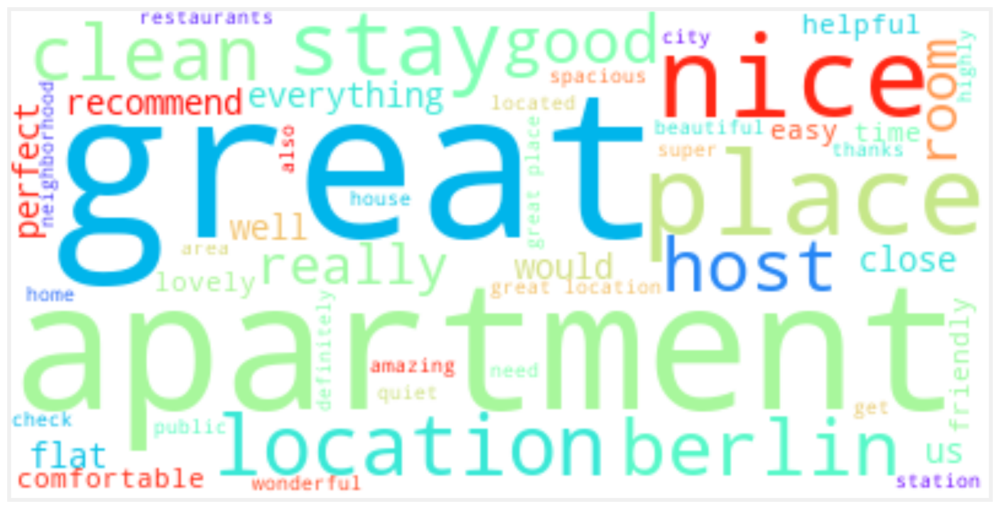

In [65]:
wc_gen = {}
wc = WordCloud(mode='RGBA',background_color='white',colormap='rainbow',random_state=2)

fig, ax = plt.subplots(figsize=(12,40))


wc_gen = wc.generate_from_frequencies(dict(c.reset_index().values))
ax.imshow(wc_gen,interpolation='bilinear')
ax.set_xticks([])
ax.set_yticks([])
    
plt.show()

In [ ]:
#df_ids=pd.merge(reviews,df,how='left',left_index=True,right_index=True)

In [ ]:
#df_ids.to_csv('berlin_review_sent_vec_sample')

In [ ]:
#df_ids_grouped=df_ids.groupby(df_ids.listing_id).agg(np.mean)

In [ ]:
#df_ids_grouped.vader_compound.iplot(kind='hist', title= 'Total Compound sentiment of a listing', xTitle= 'Vader compound',
                                   yTitle = 'Number of listings')

In [ ]:
#df_ids_grouped['sent']=df_ids_grouped.vader_compound.map(lambda x: 'pos' if x>= 0.05
 #                                       else 'neg' if x<= -0.05
 #                                       else 'neu')

In [ ]:
#df_ids_grouped.info()

In [ ]:
#df_ids_grouped.to_csv('berlin_review_grouped_sent_vec_sample')